<a href="https://colab.research.google.com/github/redddyyashwanth04/machinelearning/blob/main/TF_keras_practice.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import tensorflow as tf
from tensorflow import keras
# from tensorflow.keras import layers
import numpy as np
import matplotlib.pyplot as plt
print(tf.__version__)

2.18.0


In [ ]:
#these are the gray scale images of clothes of 60000 with (28,28)pixel
fashion_mnist=keras.datasets.fashion_mnist
(train_images,train_labels),(test_images,test_labels)=fashion_mnist.load_data()
print(train_images.shape)
print(train_labels.shape)
print(test_images.shape)
print(test_labels.shape)

29515/29515 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
26421880/26421880 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
5148/5148 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
4422102/4422102 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
(60000, 28, 28)
(60000,)
(10000, 28, 28)
(10000,)


In [ ]:
class_names = ['T-shirt/top', 'Trouser', 'Pullover', 'Dress', 'Coat', 'Sandal', 'Shirt', 'Sneaker', 'Bag', 'Ankle boot']


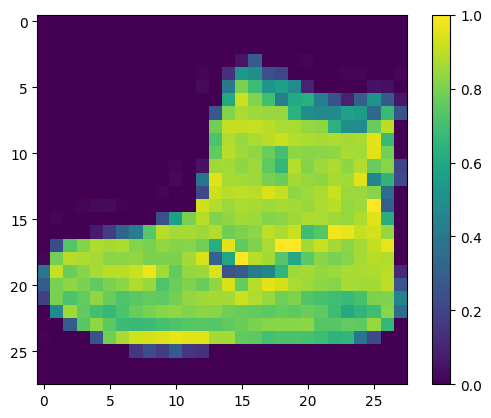

In [ ]:


train_images = train_images / 255.0 #min max scale or the normalzation
test_images = test_images / 255.0
plt.figure()
plt.imshow(train_images[0])
plt.colorbar()
plt.grid(False)
plt.show()

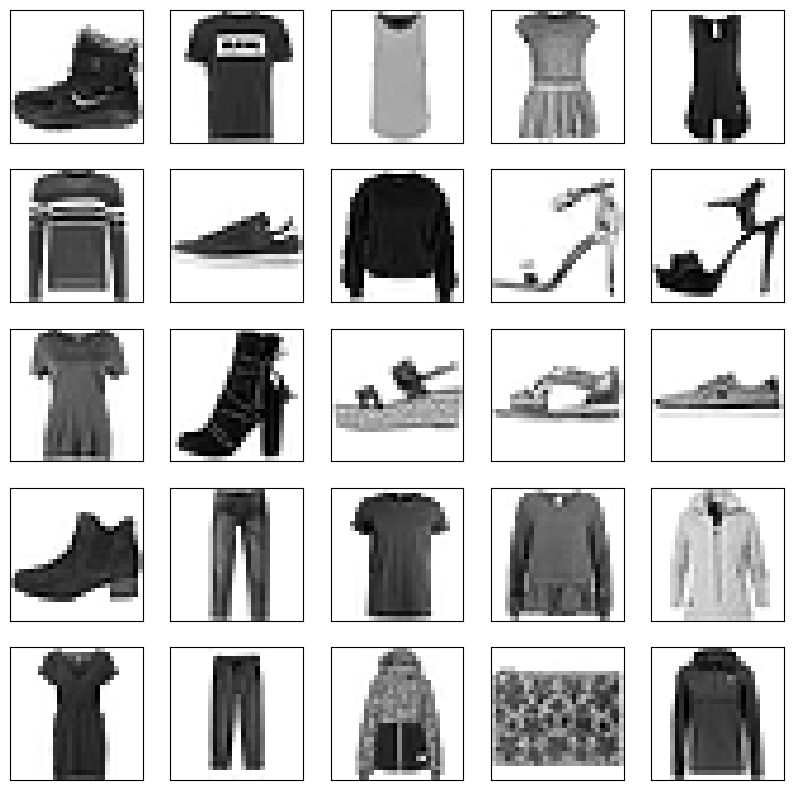

In [ ]:
plt.figure(figsize=(10,10))
for i in range(25):
  plt.subplot(5,5,i+1)
  plt.xticks([])
  plt.yticks([])
  plt.grid(False)
  plt.imshow(train_images[i], cmap=plt.cm.binary)

plt.show()

In [ ]:
#building a simple MLP
from tensorflow.keras.initializers import GlorotNormal
tf.random.set_seed(100)
model=None
model=keras.Sequential()
model.add(keras.layers.Flatten(input_shape=(28,28)))#takes 28*28 takes input
model.add(keras.layers.Dense(128,activation="relu",kernel_initializer=GlorotNormal()))
model.add(keras.layers.Dense(10))


/usr/local/lib/python3.11/dist-packages/keras/src/layers/reshaping/flatten.py:37: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


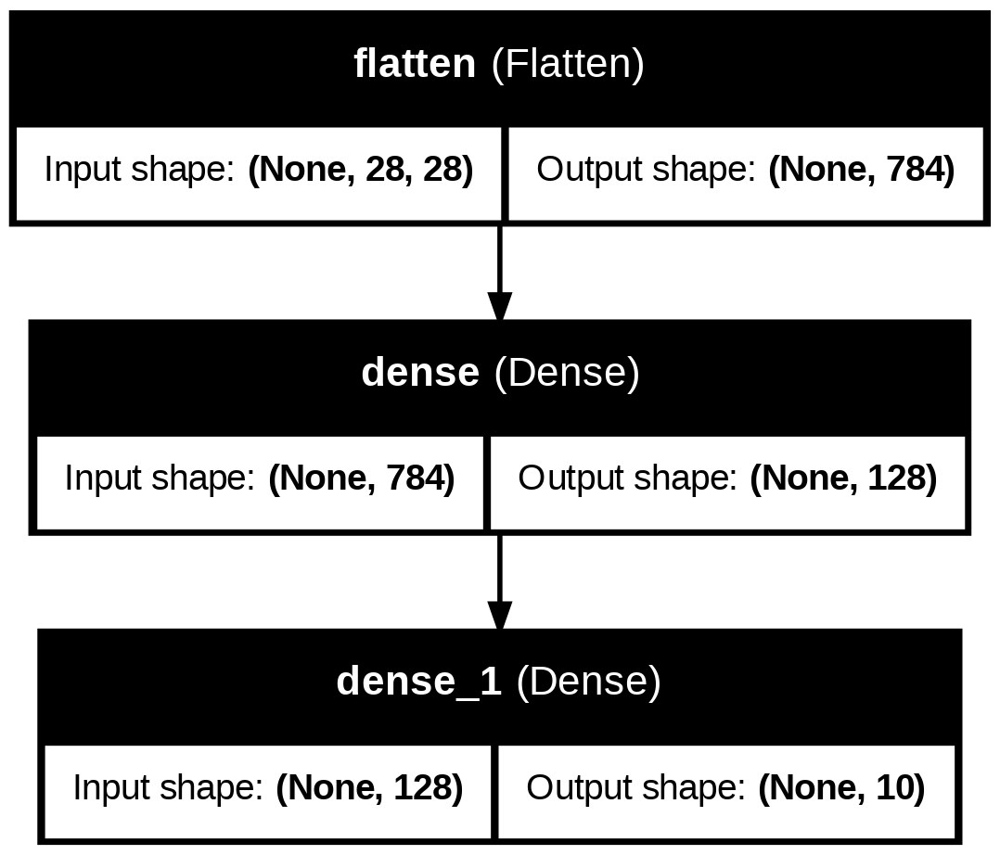

In [ ]:
from tensorflow.keras.utils import plot_model
plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [ ]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ flatten (Flatten)               │ (None, 784)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │       100,480 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 10)             │         1,290 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 101,770 (397.54 KB)

 Trainable params: 101,770 (397.54 KB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
model.compile(optimizer="adam",loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),metrics=["accuracy"])
#from logits means give the probabilistic results
#ca

In [ ]:
from logging import log
import os
import datetime
#use of tensor board
!rm -rf ./logs/
logdir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
print(logdir)
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

logs/20250701-010140


In [ ]:
%load_ext tensorboard
%tensorboard --logdir $logdir

<IPython.core.display.Javascript object>

In [ ]:
#model to logdir to tensor board
model.fit(x=train_images,y=train_labels,epochs=10,callbacks=[tensorboard_callback])

Epoch 1/10
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - accuracy: 0.7799 - loss: 0.6321
Epoch 2/10
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - accuracy: 0.8615 - loss: 0.3893
Epoch 3/10
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.8756 - loss: 0.3435
Epoch 4/10
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 10s 3ms/step - accuracy: 0.8854 - loss: 0.3164
Epoch 5/10
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 12s 4ms/step - accuracy: 0.8939 - loss: 0.2952
Epoch 6/10
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - accuracy: 0.9005 - loss: 0.2771
Epoch 7/10
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.9021 - loss: 0.2640
Epoch 8/10
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 11s 3ms/step - accuracy: 0.9072 - loss: 0.2514
Epoch 9/10
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.9108 - loss: 0.2405
Epoch 10/10
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 10s 3ms/step - accuracy: 0.9146 - loss: 0.2304


In [ ]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ flatten (Flatten)               │ (None, 784)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │       100,480 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 10)             │         1,290 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 305,312 (1.16 MB)

 Trainable params: 101,770 (397.54 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 203,542 (795.09 KB)

In [ ]:
test_loss,test_acc=model.evaluate(test_images,test_labels,verbose=2)
print(test_acc)

313/313 - 1s - 4ms/step - accuracy: 0.8748 - loss: 0.3475
0.8748000264167786


In [ ]:
!pip install -q pyyaml h5py
import os

In [ ]:
tf.keras.backend.clear_session()

check_point="traning_1/cp..weights.h5"
check_point_dir=os.path.dirname(check_point)

cp_callback=tf.keras.callbacks.ModelCheckpoint(filepath=check_point,
                                                save_weights_only=True,
                                                verbose=1)
#tensor_board
!rm -rf ./logs/
logdir=os.path.join("logs",datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
%tensorboard --logdir $logdir
tensorboard_callback=tf.keras.callbacks.TensorBoard(logdir,histogram_freq=1)
#building a simple MLP
from tensorflow.keras.initializers import GlorotNormal
tf.random.set_seed(100)
model=None
model=keras.Sequential()
model.add(keras.layers.Flatten(input_shape=(28,28)))#takes 28*28 takes input
model.add(keras.layers.Dense(128,activation="relu",kernel_initializer=GlorotNormal()))
model.add(keras.layers.Dense(10))


model.compile(optimizer="adam",loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),metrics=["accuracy"])
#from logits means give the probabilistic results
#ca
model.fit(x=train_images,y=train_labels,epochs=20,callbacks=[tensorboard_callback,cp_callback])

<IPython.core.display.Javascript object>

/usr/local/lib/python3.11/dist-packages/keras/src/layers/reshaping/flatten.py:37: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/20
1864/1875 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7806 - loss: 0.6313
Epoch 1: saving model to traning_1/cp..weights.h5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - accuracy: 0.7809 - loss: 0.6304
Epoch 2/20
1863/1875 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8624 - loss: 0.3847
Epoch 2: saving model to traning_1/cp..weights.h5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - accuracy: 0.8625 - loss: 0.3846
Epoch 3/20
1864/1875 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8781 - loss: 0.3402
Epoch 3: saving model to traning_1/cp..weights.h5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 10s 3ms/step - accuracy: 0.8781 - loss: 0.3402
Epoch 4/20
1866/1875 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8867 - loss: 0.3123
Epoch 4: saving model to traning_1/cp..weights.h5
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 10s 3ms/step - accuracy: 0.8867 - loss: 0.3123
Epoch 5/20
1873/1875 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8925 - loss: 0.2920
Epoch 5: saving model to traning_1/cp..weights.h5


In [ ]:
y_pred = np.argmax(model.predict(test_images), axis=-1)#returns the predicted classes for each class
print()

con_math=tf.math.confusion_matrix(labels=test_labels,predictions=y_pred).numpy()

313/313 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
(10000,)


In [ ]:
import pandas as pd

In [ ]:
df=pd.DataFrame(con_math,index=class_names,columns=class_names)
print(df)

             T-shirt/top  Trouser  Pullover  Dress  Coat  Sandal  Shirt  \
T-shirt/top          707        1        12     40     4       2    225   
Trouser                2      970         0     17     5       0      5   
Pullover               9        0       733     15   117       0    125   
Dress                  9        3         9    915    27       0     32   
Coat                   1        0        68     37   786       0    107   
Sandal                 1        0         0      1     0     955      0   
Shirt                 60        0        49     34    43       0    801   
Sneaker                0        0         0      0     0      18      0   
Bag                    2        0         4      4     3       2      7   
Ankle boot             0        0         0      0     0       4      1   

             Sneaker  Bag  Ankle boot  
T-shirt/top        0    9           0  
Trouser            0    1           0  
Pullover           0    1           0  
Dress         

In [ ]:
! ls traning_1


cp..weights.h5	cp.weights.h5


In [ ]:
! cat traning_1/cp.weights.h5

�HDF

                    �������� �     ��������        `              �       �                        �       �      TREE   ����������������        �                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                             HEAP    X       (       �              vars    layers  optimizer              0                                                         (      `       TREE    ����������������                                                                                                                                         

In [ ]:
def create_model():
  model = keras.Sequential([
    keras.layers.Flatten(input_shape=(28, 28)),
    keras.layers.Dense(128, activation='relu'),
    keras.layers.Dense(10)
  ])

  model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])
  return model;


In [ ]:
#already we have the weights we are just loading the wieghts into the the new model


In [ ]:
model_ckpt=create_model()
model_ckpt.load_weights('traning_1/cp.weights.h5')
model_ckpt.evaluate(test_images,test_labels,verbose=2)

/usr/local/lib/python3.11/dist-packages/keras/src/layers/reshaping/flatten.py:37: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/saving/saving_lib.py:757: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 10 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


313/313 - 1s - 5ms/step - accuracy: 0.8690 - loss: 0.4242


[0.4241635203361511, 0.8690000176429749]

creating the residual nets

In [ ]:
# TensorFlow and tf.keras
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers


In [ ]:
tf.keras.backend.clear_session()

conv layers using the functional api

In [ ]:
def resnets():
  inputs=keras.Input(shape=(32,32,3))
  x=layers.Conv2D(128,3,strides=1,activation="relu")(inputs)
  x=layers.Conv2D(64,3,strides=1,activation="relu")(x)
  otpt1=layers.MaxPooling2D(pool_size=(2,2))(x)
  x=layers.Conv2D(64,3,padding="same",activation="relu")(otpt1)
  x=layers.Conv2D(64,3,padding="same",activation="relu")(x)
  opt2=layers.add([x,otpt1])
  x=layers.Conv2D(64,3,padding="same",activation="relu")(opt2)
  x=layers.Conv2D(64,3,padding="same",activation="relu")(x)
  opt3=layers.add([x,opt2])
  x=layers.Conv2D(512,3,padding="same",activation="relu")(opt3)
  x=layers.GlobalAveragePooling2D()(x)
  x=layers.Dense(256,activation="relu")(x)
  x=layers.Dropout(0.6)(x)
  x=layers.Dense(128,activation="relu")(x)
  output=layers.Dense(10)(x)

  model = keras.Model(inputs, output, name='toy_resnet')
  return model





Model: "toy_resnet"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4       │ (None, 32, 32, 3) │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_20 (Conv2D)  │ (None, 30, 30,    │      3,584 │ input_layer_4[0]… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_21 (Conv2D)  │ (None, 28, 28,    │     73,792 │ conv2d_20[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_4     │ (None, 14, 14,    │          0 │ conv2d_21[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_22 (Conv2D)  │ (None, 14, 14,    │     36,928 │ max_pooling2d_4[… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_23 (Conv2D)  │ (None, 14, 14,    │     36,928 │ conv2d_22[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_5 (Add)         │ (None, 14, 14,    │          0 │ conv2d_23[0][0],  │
│                     │ 64)               │            │ max_pooling2d_4[… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_24 (Conv2D)  │ (None, 14, 14,    │     36,928 │ add_5[0][0]       │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_25 (Conv2D)  │ (None, 14, 14,    │     36,928 │ conv2d_24[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_6 (Add)         │ (None, 14, 14,    │          0 │ conv2d_25[0][0],  │
│                     │ 64)               │            │ add_5[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_26 (Conv2D)  │ (None, 14, 14,    │    295,424 │ add_6[0][0]       │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_average_poo… │ (None, 512)       │          0 │ conv2d_26[0][0]   │
│ (GlobalAveragePool… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_6 (Dense)     │ (None, 256)       │    131,328 │ global_average_p… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_2 (Dropout) │ (None, 256)       │          0 │ dense_6[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_7 (Dense)     │ (None, 128)       │     32,896 │ dropout_2[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_8 (Dense)     │ (None, 10)        │      1,290 │ dense_7[0][0]     │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 686,026 (2.62 MB)

 Trainable params: 686,026 (2.62 MB)

 Non-trainable params: 0 (0.00 B)

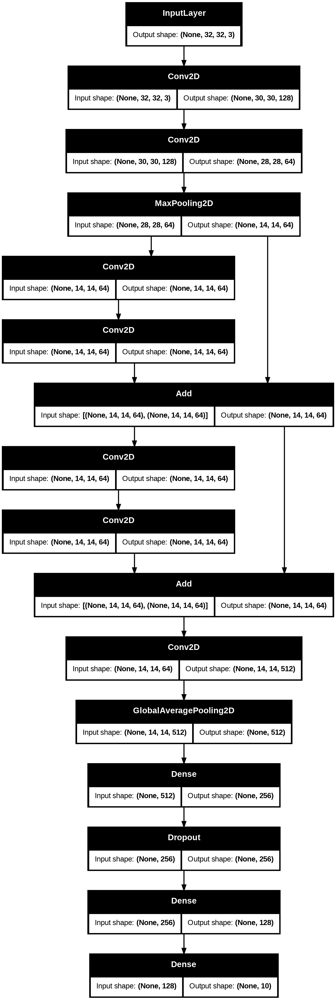

In [ ]:
model=resnets()
model.summary()
keras.utils.plot_model(model,show_shapes=True)

In [ ]:
data=keras.datasets.cifar10
(train_images,train_labels),(test_images,test_labels)=data.load_data()
print(train_images.shape)
print(train_labels.shape)
print(test_images.shape)
print(test_labels.shape )

170498071/170498071 ━━━━━━━━━━━━━━━━━━━━ 4s 0us/step
(50000, 32, 32, 3)
(50000, 1)
(10000, 32, 32, 3)
(10000, 1)


In [ ]:
#preprocessing the data
train_images=train_images.astype("float32")/255.
test_images=test_images.astype("float32")/255.
y_train=keras.utils.to_categorical(train_labels,10)
y_test=keras.utils.to_categorical(test_labels,10)


In [ ]:
#loading the data
 (x_train, y_train), (x_test, y_test) = keras.datasets.cifar10.load_data()

# pre-process
x_train = x_train.astype('float32') / 255.
x_test = x_test.astype('float32') / 255.
y_train = keras.utils.to_categorical(y_train, 10)
y_test = keras.utils.to_categorical(y_test, 10)
print(x_train.shape)
print(x_test.shape)

model.compile(optimizer='adam',
              loss=keras.losses.CategoricalCrossentropy(from_logits=True),##from_logits=True if your model's output layer does
              #NOT have a softmax activation, and set it to False if your model outputs probabilities
              metrics=[keras.metrics.Precision()])

model.fit(x_train, y_train,
          batch_size=64,
          epochs=15,
          validation_split=0.2)

(50000, 32, 32, 3)
(10000, 32, 32, 3)
Epoch 1/15
625/625 ━━━━━━━━━━━━━━━━━━━━ 18s 21ms/step - loss: 0.1482 - precision: 0.4602 - val_loss: 1.0160 - val_precision: 0.4020
Epoch 2/15
625/625 ━━━━━━━━━━━━━━━━━━━━ 11s 18ms/step - loss: 0.1241 - precision: 0.4698 - val_loss: 0.9940 - val_precision: 0.4037
Epoch 3/15
625/625 ━━━━━━━━━━━━━━━━━━━━ 11s 18ms/step - loss: 0.1097 - precision: 0.4716 - val_loss: 0.9861 - val_precision: 0.4105
Epoch 4/15
625/625 ━━━━━━━━━━━━━━━━━━━━ 12s 18ms/step - loss: 0.1217 - precision: 0.4750 - val_loss: 0.9718 - val_precision: 0.4133
Epoch 5/15
625/625 ━━━━━━━━━━━━━━━━━━━━ 11s 18ms/step - loss: 0.1098 - precision: 0.4777 - val_loss: 1.1004 - val_precision: 0.4123
Epoch 6/15
625/625 ━━━━━━━━━━━━━━━━━━━━ 11s 18ms/step - loss: 0.1195 - precision: 0.4790 - val_loss: 1.0634 - val_precision: 0.4271
Epoch 7/15
625/625 ━━━━━━━━━━━━━━━━━━━━ 11s 18ms/step - loss: 0.1027 - precision: 0.4979 - val_loss: 1.0760 - val_precision: 0.4206
Epoch 8/15
625/625 ━━━━━━━━━━━━━━━━━━━

saving the model

In [ ]:
!mkdir -p savedmodel

In [ ]:
model.save("savedmodel/my_model.keras")

In [ ]:
!ls savedmodel

my_model.keras
